In [33]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [34]:
df = pd.read_csv("../2_Feature_Extraction_test_all_data/extract_features/tracking_features.csv")
df.head()


,tracking_id,num_points,bbox_area,point_density,avg_segment_distance,num_stops
0,96435,1092,0.037478,29136.266350,74.353047,1092
1,96436,1965,0.030543,64332.732343,68.475822,1965
2,96437,1631,0.029632,55040.207972,64.862972,1631
3,96438,2043,0.020103,101623.875093,63.076106,2043
4,96439,2266,0.073024,31030.518246,58.472769,2266


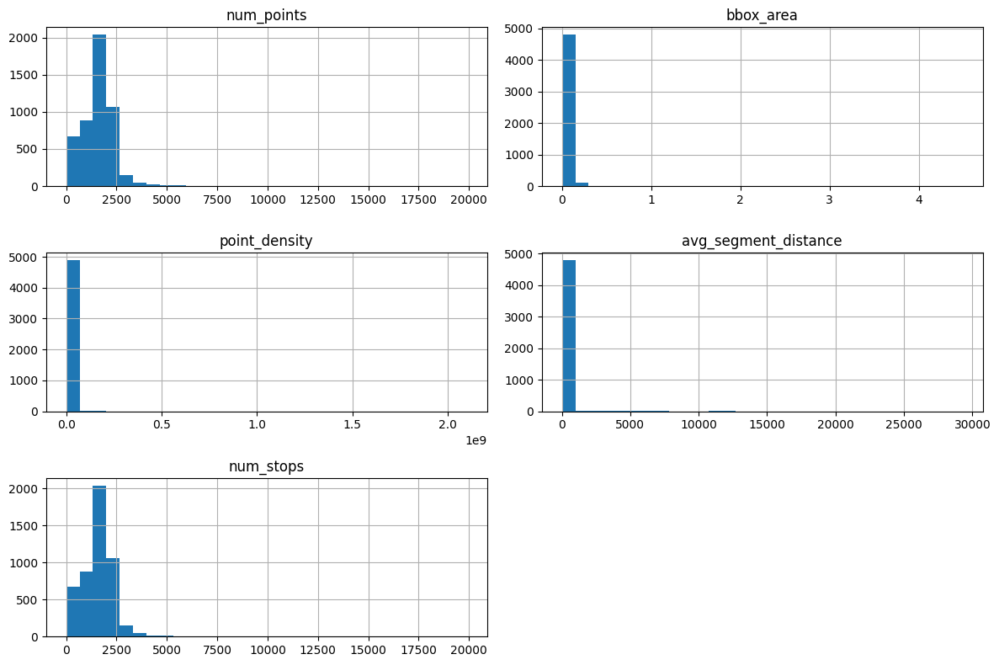

In [35]:
df.drop(columns=["tracking_id"]).hist(figsize=(12, 8), bins=30)
plt.tight_layout()
plt.show()


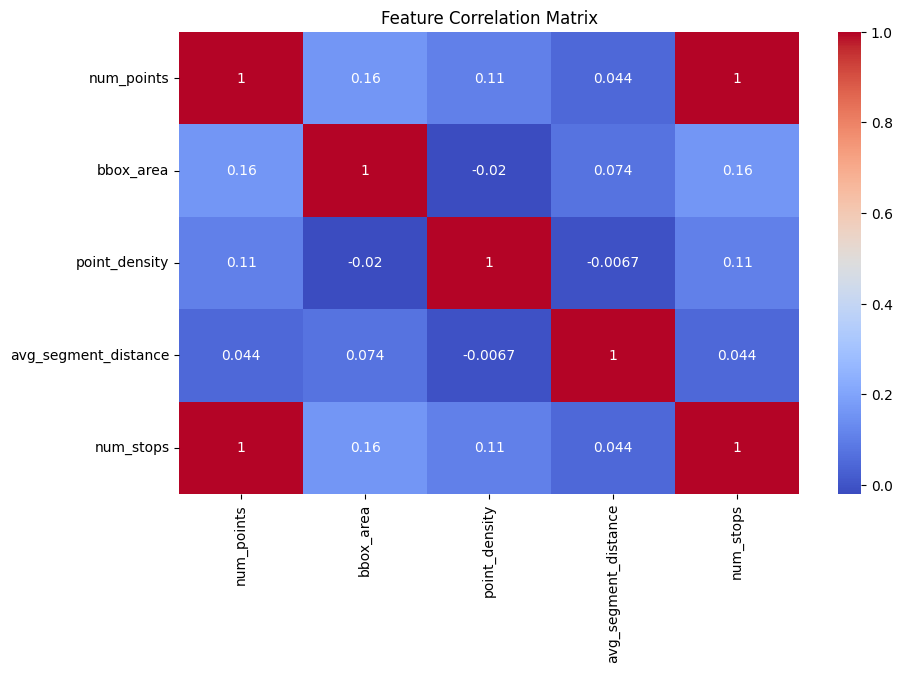

In [36]:
plt.figure(figsize=(10, 6))
sns.heatmap(df.drop(columns=["tracking_id"]).corr(), annot=True, cmap="coolwarm")
plt.title("Feature Correlation Matrix")
plt.show()


In [21]:
# df = df[(df["avg_segment_distance"] < 1000)]


In [37]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

X_scaled = StandardScaler().fit_transform(df.drop(columns=["tracking_id"]))

db = DBSCAN(eps=1, min_samples=40)
df["cluster"] = db.fit_predict(X_scaled)

df.head()


,tracking_id,num_points,bbox_area,point_density,avg_segment_distance,num_stops,cluster
0,96435,1092,0.037478,29136.266350,74.353047,1092,0
1,96436,1965,0.030543,64332.732343,68.475822,1965,0
2,96437,1631,0.029632,55040.207972,64.862972,1631,0
3,96438,2043,0.020103,101623.875093,63.076106,2043,0
4,96439,2266,0.073024,31030.518246,58.472769,2266,0


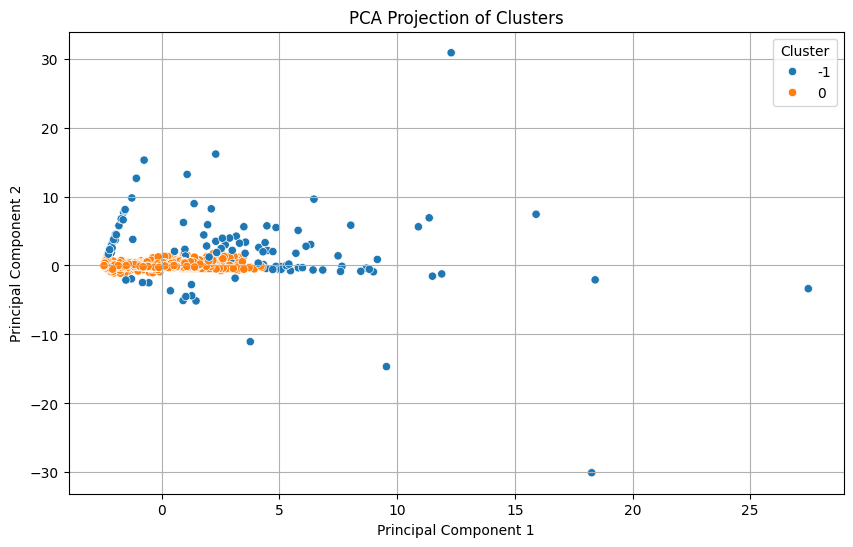

In [38]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

df["pca1"] = X_pca[:, 0]
df["pca2"] = X_pca[:, 1]

plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x="pca1", y="pca2", hue="cluster", palette="tab10")
plt.title("PCA Projection of Clusters")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.grid(True)
plt.legend(title="Cluster")
plt.show()


In [39]:
df_clean = df[df["cluster"] != -1].copy()
print(f"Removed {len(df) - len(df_clean)} outliers with DBSCAN")

Removed 122 outliers with DBSCAN


In [40]:
# X = df.drop(columns=["tracking_id"])
# scaler = StandardScaler()
# X_scaled = scaler.fit_transform(X)

# kmeans = KMeans(n_clusters=4, random_state=42)
# df["cluster"] = kmeans.fit_predict(X_scaled)
print(len(df_clean))

4787


In [41]:
from sklearn.cluster import KMeans

X_clean = df_clean.drop(columns=["tracking_id", "cluster"])
X_clean_scaled = StandardScaler().fit_transform(X_clean)

kmeans = KMeans(n_clusters=4, random_state=42)
df_clean["cluster"] = kmeans.fit_predict(X_clean_scaled)

df = df_clean
print(df.head())

   tracking_id  num_points  bbox_area  point_density  avg_segment_distance  \
0        96435        1092   0.037478   29136.266350             74.353047   
1        96436        1965   0.030543   64332.732343             68.475822   
2        96437        1631   0.029632   55040.207972             64.862972   
3        96438        2043   0.020103  101623.875093             63.076106   
4        96439        2266   0.073024   31030.518246             58.472769   

   num_stops  cluster      pca1      pca2  
0       1092        3 -0.737997  0.054463  
1       1965        2  0.554381 -0.133790  
2       1631        2  0.050634 -0.089388  
3       2043        2  0.644953 -0.221176  
4       2266        2  1.112410  0.106522  


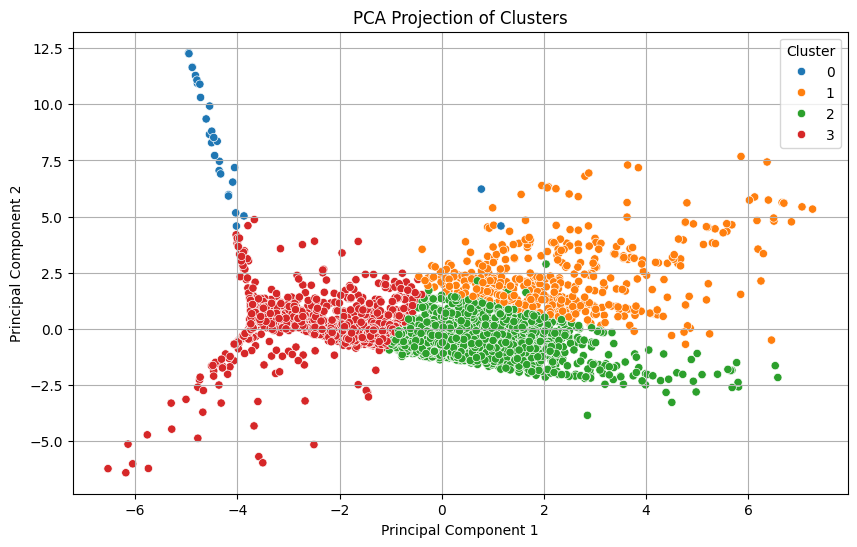

In [42]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_clean_scaled)

df["pca1"] = X_pca[:, 0]
df["pca2"] = X_pca[:, 1]

plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x="pca1", y="pca2", hue="cluster", palette="tab10")
plt.title("PCA Projection of Clusters")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.grid(True)
plt.legend(title="Cluster")
plt.show()


In [43]:
df.describe()
df[df['cluster'] == 2].sort_values("point_density").head()

,tracking_id,num_points,bbox_area,point_density,avg_segment_distance,num_stops,cluster,pca1,pca2
3980,100422,1151,0.073748,15607.033271,104.533325,1151,2,-0.252745,1.780980
3981,100423,1166,0.071484,16311.137520,109.238829,1166,2,-0.252462,1.715611
3695,100137,1303,0.075158,17336.651017,75.813641,1303,2,0.100514,1.567648
3363,99802,1182,0.066036,17899.147154,105.837795,1182,2,-0.287973,1.520077
4022,100464,1283,0.070880,18100.635969,86.902038,1283,2,-0.002430,1.498724


In [44]:
# Summarize feature means by cluster
summary = df.groupby("cluster").mean(numeric_only=True)
summary["count"] = df["cluster"].value_counts().sort_index()
summary


,tracking_id,num_points,bbox_area,point_density,avg_segment_distance,num_stops,pca1,pca2,count
cluster,,,,,,,,,
0,100080.586207,173.068966,0.004720,1.754057e+04,2117.578058,173.068966,-4.105352,8.434472,29
1,98894.511931,2101.665944,0.120914,1.904234e+04,100.288417,2101.665944,2.379135,2.305271,461
2,98506.817592,1839.477767,0.026280,1.310177e+05,65.441855,1839.477767,0.602304,-0.490425,3081
3,99766.252467,599.602796,0.010422,1.994992e+06,97.955775,599.602796,-2.330120,0.167492,1216


In [45]:
N = 200
example_ids = df.groupby("cluster")["tracking_id"].apply(lambda x: x.sample(min(N, len(x)), random_state=42)).explode().tolist()

waypoints = pd.read_parquet("../2_Feature_Extraction_test_all_data/data/all_gps_data_without_sorting.parquet")

example_routes = waypoints[waypoints["id_tracking"].isin(example_ids)].copy()


In [46]:
# import folium
# from folium import Map, PolyLine
# from IPython.display import display

# cluster_colors = ["blue", "orange", "green", "red"]

# for tracking_id in example_ids:
#     route = example_routes[example_routes["id_tracking"] == tracking_id].sort_values(by="sequence")
#     coords = list(zip(route["latitude"], route["longitude"]))
#     cluster_label = df[df["tracking_id"] == tracking_id]["cluster"].values[0]
    
#     m = folium.Map(location=coords[0], zoom_start=13)
#     folium.PolyLine(coords, color=cluster_colors[cluster_label], weight=5).add_to(m)
#     folium.Marker(coords[0], tooltip=f"Tracking {tracking_id} - Cluster {cluster_label}").add_to(m)
#     display(m)

import folium
from folium import Map, PolyLine, Marker
from IPython.display import display

cluster_colors = ["blue", "orange", "green", "red"]

first_route = example_routes[example_routes["id_tracking"] == example_ids[0]].sort_values("sequence")
center = [first_route.iloc[0]["latitude"], first_route.iloc[0]["longitude"]]

m = folium.Map(location=center, zoom_start=12)

for tracking_id in example_ids:
    route = example_routes[example_routes["id_tracking"] == tracking_id].sort_values(by="sequence")
    coords = list(zip(route["latitude"], route["longitude"]))
    cluster_label = df[df["tracking_id"] == tracking_id]["cluster"].values[0]

    folium.PolyLine(coords, color=cluster_colors[cluster_label], weight=4, tooltip=f"Cluster {cluster_label}").add_to(m)
    Marker(coords[0], tooltip=f"Tracking {tracking_id}").add_to(m)

display(m)


In [47]:
# manually assign labels to clusters depending on point density because it is a good factor as determined in the data analysis

cluster_to_label = {
    0: "URBAN", # Blue
    1: "SUBURBAN", # Orange 
    2: "TOWN", # Green
    3: "RURAL" # Red
}

df["predicted_label"] = df["cluster"].map(cluster_to_label)
df.to_csv("tracking_features_with_labels.csv", index=False)
print("saved predicted labels to csv")


saved predicted labels to csv
